In [ ]:
# Exploring Occupancy and Modeling Interactive plots

In [44]:
# Importing libraries
import os
import pandas as pd
import numpy as np
import pyarrow as pa
import pyarrow.parquet as pq
import math
import matplotlib.pyplot as plt
import geopandas as gpd
import folium
from folium import plugins
from folium.plugins import MarkerCluster
import branca.colormap as cm
from branca.colormap import LinearColormap
from sklearn.cluster import DBSCAN
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import accuracy_score, r2_score, mean_squared_error
from sklearn.inspection import plot_partial_dependence

In [3]:
# Setting working directory
direc_path = '/datar10/jupyter/user/josh.hall/condaenvs/MYENV/DATA-793 Capstone Curbside/dc_data'

os.chdir(direc_path)

In [4]:
# Loading in files from final cleaning stage in `02_data_cleaning.ipynb`
merge_21 = pd.read_parquet('dc_merge_21.parquet')

In [5]:
merge_22 = pd.read_parquet('dc_merge_22.parquet')

In [6]:
merge_23 = pd.read_parquet('dc_merge_23.parquet')

In [7]:
# Due to DC parking enforcement restarting in June of 2021, June 2021-forward will be what is looked at for occupancy questions
# Isolating valid 2021 times
merge_21_valid = merge_21[merge_21['paymentstart'] >= '2021-06-01']

In [8]:
# Creating a new data table that contains all valid parking transactions and information from June 2021-June 2023
post_covid_enforcement = [merge_21_valid, merge_22, merge_23]

In [ ]:
# Putting all valid enforcement times together 
full_merge = pd.concat(post_covid_enforcement)

In [ ]:
# Renaming and removing any nulls potentially present
def renaming_nulls(df):
    return df.replace("NULL", np.nan)

In [11]:
full_merge = renaming_nulls(full_merge)
full_merge.isna().sum()

meternumber          0
zone                 0
paymentstart         0
paymentexpiry        0
paymentamount        0
paymenttype          0
transactionsender    0
blk_no               0
street               0
address              0
numberofsp           0
longitude            0
latitude             0
dtype: int64

In [12]:
# Attempting to get a more accurate denominator for valid policy hours
# Going to multiply policy hours by total spots available for each meter (using 'numberofsp') column 
# to acquire as accurate of a denominator as possible
policies = pd.read_parquet('dc_policies.parquet')

In [13]:
policies

,meternumber,policy,effectivedate
0,10052003.0,07:00AM-06:30PM MON-SAT $2.30 240 | TOW: | CL...,2018-01-09 19:00:00.000
1,10052003.0,07:00AM-06:30PM MON-SAT $2.30 240 | TOW: | CL...,2018-04-05 21:00:00.000
2,10052003.0,07:00AM-06:30PM MON-SAT $2.30 240 | TOW: | CL...,2018-05-01 20:00:00.000
3,10052003.0,07:00AM-06:30PM MON-SAT $2.30 240 | TOW: | CL...,2018-05-02 20:00:00.000
4,10052003.0,07:00AM-06:30PM MON-SAT $2.30 240 | TOW: | CL...,2018-05-22 20:00:00.000
...,...,...,...
124811,20090592.0,"7AM-11AM Mon-Fri $2.30 120, 11AM-4PM Mon-Fri $...",2023-05-25 01:48:32.117
124812,20151214.0,"7AM-6:30PM Mon-Sat $2.30 120, 6:30PM-10PM Mon-...",2023-06-01 20:00:00.000
124813,20151214.0,"07:00AM-06:30PM MON-SAT $2.30 120, 06:30PM-10:...",2023-06-02 07:43:28.600
124814,20171309.0,"9:30AM-4PM Mon-Fri $2.30 120, 6:30PM-10PM Mon-...",2023-06-07 08:36:33.230


In [14]:
# Removing duplicate policies 
policies = policies.drop_duplicates().copy()
policies = policies.drop_duplicates(subset=['meternumber']).copy() # Isolating to one policy per meter to simplify from base 100k+ table length
policies = policies.dropna(subset=['meternumber'])
policies = policies.loc[policies['meternumber'] != 0]

In [15]:
# Specifically coding to incorporate the most common meter policy hours (for all meters where more than 
# 150 meters following that policy, will set all other meters to standard meter policy of 11.5 hours a day)
conditions = [
    (policies['policy'] == '07:00AM-06:30PM MON-SAT $2.30 120 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-07:00AM MON-SAT, 06:30PM-24:00AM MON-SAT'),
    (policies['policy'] == '07:00AM-06:30PM MON-SAT $2.30 120, 06:30PM-10:00PM MON-SAT $2.30 210 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-07:00AM MON-SAT, 10:00PM-24:00AM MON-SAT'),
    (policies['policy'] == '07:00AM-06:30PM SAT $2.30 120, 09:30AM-04:00PM MON-FRI $2.30 120, 06:30PM-10:00PM MON-SAT $2.30 210 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-09:30AM MON-FRI, 00:00AM-07:00AM SAT, 04:00PM-06:30PM MON-FRI, 10:00PM-24:00AM MON-SAT'),
    (policies['policy'] == '07:00AM-06:30PM MON-SAT $2.30 240 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-07:00AM MON-SAT, 06:30PM-24:00AM MON-SAT'),
    (policies['policy'] == '07:00AM-06:30PM MON-SAT $2.30 60 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-07:00AM MON-SAT, 06:30PM-24:00AM MON-SAT'),
    (policies['policy'] == '07:00AM-06:30PM SAT $2.30 120, 09:30AM-04:00PM MON-FRI $2.30 120 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-09:30AM MON-FRI, 00:00AM-07:00AM SAT, 04:00PM-24:00AM MON-FRI, 06:30PM-24:00AM SAT'), 
    (policies['policy'] == '07:00AM-04:00PM MON-FRI $2.30 120, 07:00AM-06:30PM SAT $2.30 120, 06:30PM-10:00PM MON-SAT $2.30 210 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-07:00AM MON-SAT, 04:00PM-06:30PM MON-FRI, 10:00PM-24:00AM MON-SAT'),
    (policies['policy'] == '07:00AM-06:30PM SAT $2.30 120, 09:30AM-06:30PM MON-FRI $2.30 120, 06:30PM-10:00PM MON-SAT $2.30 210 | TOW:  | CLEAN:  | PREPAY:  | PARKNOPAY: 00:00AM-24:00AM SUN, 00:00AM-09:30AM MON-FRI, 00:00AM-07:00AM SAT, 10:00PM-24:00AM MON-SAT')
]

In [16]:
values = [11.5, 15, 10, 11.5, 11.5, 6.5, 11.5, 12.5]  # Values corresponding to the conditions

# Setting policy hours based on the conditions, with a default of 11.5
policies['policy_hours'] = np.select(conditions, values, default=11.5)

In [17]:
# Dropping long policy column and implementation date
policies.drop(columns=['policy', 'effectivedate'], inplace=True)

In [18]:
# Setting 'meternumber' as string for merge
policies['meternumber'] = policies['meternumber'].astype(str)

In [19]:
# Merging data with a corresponding policy
merge_poli = pd.merge(full_merge, policies, left_on='meternumber', right_on='meternumber', how='left')

In [20]:
# Not all meters matched a policy hour, filling in NAs with standard 11.5 meter policy hours
merge_poli['policy_hours'].fillna(11.5, inplace=True)

In [21]:
# Checking for nulls
merge_poli.isna().sum()

meternumber          0
zone                 0
paymentstart         0
paymentexpiry        0
paymentamount        0
paymenttype          0
transactionsender    0
blk_no               0
street               0
address              0
numberofsp           0
longitude            0
latitude             0
policy_hours         0
dtype: int64

In [22]:
# Occupancy Model
# At the meter level, daily
# ((sum of total payment length) / (number of available spaces * policy hours)) * 100
# = % Occupancy
full_merge_poli = merge_poli.copy()
full_merge_poli['numberofsp'] = pd.to_numeric(full_merge_poli['numberofsp'], errors='coerce')
full_merge_poli['paymentstart'] = pd.to_datetime(full_merge_poli['paymentstart'])
full_merge_poli['paymentexpiry'] = pd.to_datetime(full_merge_poli['paymentexpiry'])

# Calculating/creating numerator
full_merge_poli['payment_length'] = (full_merge_poli['paymentexpiry'] - full_merge_poli['paymentstart']).dt.total_seconds() / 3600  # in hours
# Calculating/creating denominator
full_merge_poli['total_time_available'] = full_merge_poli['numberofsp'] * full_merge_poli['policy_hours']

# Grouping by day at meter level and keeping relevant columns for regression and plotting
full_merge_poli= full_merge_poli.groupby([full_merge_poli['paymentstart'].dt.date, full_merge_poli['meternumber']], as_index=False).agg({
    'payment_length': 'sum',
    'total_time_available': 'sum',
    'longitude': 'first',
    'latitude': 'first',
    'address': 'first',
    'paymenttype': 'first',
    'zone': 'first',
    'paymentstart': 'first',
    'paymentexpiry': 'first'
})

# Calculating occupancy percentage
full_merge_poli['occupancy_percentage'] = (full_merge_poli['payment_length'] / full_merge_poli['total_time_available']) * 100

In [23]:
# Calculating average occupancy across the full two years of data
average_meter_occ = full_merge_poli.groupby(['meternumber', 'longitude', 'latitude'])['occupancy_percentage'].mean().reset_index()
average_meter_occ = average_meter_occ.rename(columns={'occupancy_percentage': 'mean_occupancy_pct'})
average_meter_occ.head()

,meternumber,longitude,latitude,mean_occupancy_pct
0,10042291,-77.01791,38.92017,0.638854
1,10042293,-77.01791,38.9202,2.308715
2,10042391,-77.01799,38.92061,2.345379
3,10052001,-77.01875,38.91743,9.174261
4,10052003,-77.01875,38.91743,1.921714


In [24]:
# Checking to see how many meters have over 100% occupancy
average_meter_occ[average_meter_occ['mean_occupancy_pct'] > 100].sort_values(by='mean_occupancy_pct', ascending = True)

,meternumber,longitude,latitude,mean_occupancy_pct
853,20200991,-77.04482,38.90184,163.023764
1422,21082192,-77.04817,38.89953,176.989676
5107,64630591,-77.02615,38.88389,229.963559
2496,25161991,-77.04403,38.90795,235.195571
1897,21192092,-77.04559,38.91593,237.256428
1037,20311291,-77.06112,38.9058,248.840783
149,11211392,-77.03047,38.91806,281.996640
2108,22492491,-77.05223,38.90339,330.589255
4991,62610492,-77.01817,38.88449,357.674658
4205,60680492,-77.01513,38.88361,373.240392


In [25]:
# Mean of all meters (across length of data)
average_meter_occ['mean_occupancy_pct'].mean()

12.669354893071537

In [26]:
# Isolating meters that have over 200% occupancy, which is likely an error caused by a combination of 
# an incorrect provided number of spaces and the forcing of an entire popular zone's transactions 
# onto one meter
over_200_list = average_meter_occ[average_meter_occ['mean_occupancy_pct'] > 200]['meternumber'].tolist()

In [27]:
over_200_list

['11211392',
 '11211493',
 '20311291',
 '21082391',
 '21122591',
 '21131891',
 '21192092',
 '22492491',
 '25161991',
 '60581792',
 '60581794',
 '60680492',
 '61500092',
 '62610492',
 '64630591',
 '65000092']

In [28]:
# Securing the mean for all instances with below 200% occupancy
avg_occ_under_200 = average_meter_occ.copy()

# Filtering out 200+ % occupancy rows
avg_occ_under_200 = avg_occ_under_200[~avg_occ_under_200['meternumber'].isin(over_200_list)]

In [79]:
# mean of meters below 200% occupancy across the two years of data
avg_occ_under_200['mean_occupancy_pct'].mean()

8.59170451474873

In [30]:
# Was having an issue with removing meter numbers over 200% through lists, calling individually to be safe:
merge_poli_test = merge_poli[merge_poli['meternumber'] != '65000092']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '64630591']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '62610492']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '61500092']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '60680492']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '60581794']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '60581792']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '11211392']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '11211493']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '20311291']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '21082391']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '21122591']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '21131891']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '22492491']
merge_poli_test = merge_poli_test[merge_poli_test['meternumber'] != '25161991']

In [31]:
merge_poli_test

,meternumber,zone,paymentstart,paymentexpiry,paymentamount,paymenttype,transactionsender,blk_no,street,address,numberofsp,longitude,latitude,policy_hours
0,32645338,21867,2021-06-01 13:44:18,2021-06-01 14:36:29,2.0,CreditCard,IPS,5300,WISCONSIN AVE NW,5300 WISCONSIN AVE NW W,1,-77.08553,38.96012,11.5
1,32645338,21867,2021-06-01 15:15:20,2021-06-01 15:34:54,0.75,Cash,IPS,5300,WISCONSIN AVE NW,5300 WISCONSIN AVE NW W,1,-77.08553,38.96012,11.5
2,32645338,21867,2021-06-01 15:15:51,2021-06-01 15:41:26,0.25,Cash,IPS,5300,WISCONSIN AVE NW,5300 WISCONSIN AVE NW W,1,-77.08553,38.96012,11.5
3,32645338,21867,2021-06-01 15:41:55,2021-06-01 15:54:58,0.5,Cash,IPS,5300,WISCONSIN AVE NW,5300 WISCONSIN AVE NW W,1,-77.08553,38.96012,11.5
4,32645338,21867,2021-06-01 20:26:46,2021-06-01 20:33:18,0.25,Cash,IPS,5300,WISCONSIN AVE NW,5300 WISCONSIN AVE NW W,1,-77.08553,38.96012,11.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15250226,20101002,23803,2023-06-28 17:39:42,2023-06-28 18:39:42,2.3,PayByCell,PARKMOBILE,1000,10TH ST NW,1000 10TH ST NW W,1,-77.02608,38.90313,11.5
15250227,20101002,23803,2023-06-28 18:40:40,2023-06-28 19:40:40,2.3,PayByCell,PARKMOBILE,1000,10TH ST NW,1000 10TH ST NW W,1,-77.02608,38.90313,11.5
15250228,21070701,23523,2023-06-29 10:37:28,2023-06-29 12:37:28,6.75,PayByCell,PARKMOBILE,700,G ST NW,700 G ST NW N,1,-77.02275,38.89853,11.5
15250229,21070701,23523,2023-06-29 12:32:36,2023-06-29 14:37:28,9.5,PayByCell,PARKMOBILE,700,G ST NW,700 G ST NW N,1,-77.02275,38.89853,11.5


In [32]:
# Calculating occupancy without meters over 200% occupancy
# As mentioned above, had issue simply removing through list. Repeating process on smaller data set
# to avoid any further conflict
full_merge_under = merge_poli_test.copy()
full_merge_under['numberofsp'] = pd.to_numeric(full_merge_under['numberofsp'], errors='coerce')
full_merge_under['paymentstart'] = pd.to_datetime(full_merge_under['paymentstart'])
full_merge_under['paymentexpiry'] = pd.to_datetime(full_merge_under['paymentexpiry'])
# Calculating/creating numerator
full_merge_under['payment_length'] = (full_merge_under['paymentexpiry'] - full_merge_under['paymentstart']).dt.total_seconds() / 3600  # in hours
# Calculating/creating denominator
full_merge_under['total_time_available'] = full_merge_under['numberofsp'] * full_merge_under['policy_hours']

# Grouping by day at meter level and keeping relevant columns for regression and plotting
full_merge_under= full_merge_under.groupby([full_merge_under['paymentstart'].dt.date, full_merge_under['meternumber']], as_index=False).agg({
    'payment_length': 'sum',
    'total_time_available': 'sum',
    # Retain all other columns
    'longitude': 'first',
    'latitude': 'first',
    'address': 'first',
    'paymenttype': 'first',
    'zone': 'first',
    'paymentstart': 'first',
    'paymentexpiry': 'first'
})

# Calculating occupancy percentage
full_merge_under['occupancy_percentage'] = (full_merge_under['payment_length'] / full_merge_under['total_time_available']) * 100

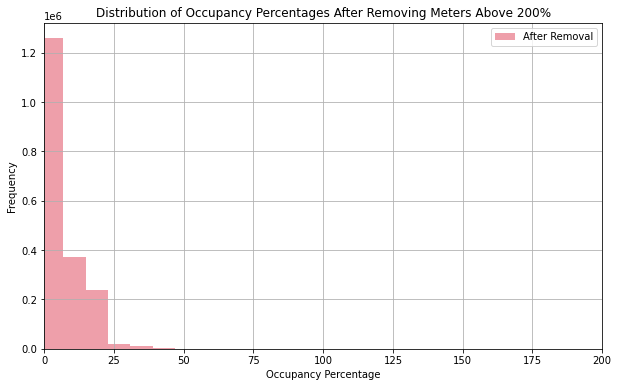

In [33]:
# Plotting a histogram for occupancy percentages after removing meters above 200%
plt.figure(figsize=(10, 6))
plt.hist(full_merge_under['occupancy_percentage'], bins=10000, color='#DE4057', alpha=0.5, label='After Removal')
plt.xlabel('Occupancy Percentage')
plt.ylabel('Frequency')
plt.title('Distribution of Occupancy Percentages After Removing Meters Above 200%')
plt.legend()
plt.grid(True)
plt.xlim(0, 200)
plt.show()

In [76]:
# Ensuring longitude and latitude columns are numeric to prepare for conversion to geo column
average_meter_occ['latitude'] = pd.to_numeric(average_meter_occ['latitude'], errors='coerce')
average_meter_occ['longitude'] = pd.to_numeric(average_meter_occ['longitude'], errors='coerce')

In [77]:
# Turning long and lat columns into a geometry column
gdf_occ_full = gpd.GeoDataFrame(average_meter_occ, geometry=gpd.points_from_xy(average_meter_occ.longitude, average_meter_occ.latitude))
# Double-checking CRS
gdf_occ_full.crs = "EPSG:4326" 

In [80]:
# Plotting all meters without clustering, may be useful for reference
# Setting colors based off of occupancy percentage
colormap = LinearColormap(['blue', 'green', 'yellow', 'red'], vmin=0, vmax=100) 
# Centering in D.C.
m_general = folium.Map(location=[38.9072, -77.0369], zoom_start=12)
# Creating clusters for points and setting points up
marker_cluster = plugins.MarkerCluster().add_to(m_general)
for index, row in gdf_occ_full.iterrows():
    color = colormap(row["mean_occupancy_pct"]) 
    folium.CircleMarker(location=[row['latitude'], row['longitude']], 
                        radius=5, 
                        color=color, 
                        fill=True,
                        fill_color=color, 
                        fill_opacity=0.7,
                        popup=f'Meter Number: {row["meternumber"]}<br>Occupancy Percentage: {row["mean_occupancy_pct"]}%').add_to(marker_cluster)
colormap.add_to(m_general)
# Display:
m_general

In [78]:
# DBSCAN Leaflet Full Data (no training or testing split in predicting occupancy, just in clustering)
# Removing potential missing values
gdf_occ_full.dropna(inplace=True)
gdf_occ_full.replace([np.inf, -np.inf], np.nan, inplace=True)
gdf_occ_full.dropna(inplace=True)

# Setting up x variable
X_full = gdf_occ_full[['latitude', 'longitude', 'mean_occupancy_pct']]

# Standardization of X data and applying clustering
X_scaled_full = StandardScaler().fit_transform(X_full)
dbscan = DBSCAN(eps=0.1, min_samples=5)
clusters = dbscan.fit_predict(X_scaled_full)
gdf_occ_full['predicted_cluster'] = clusters

# Plotting
m_full = folium.Map(location=[38.9072, -77.0369], zoom_start=12)

# Plotting points and clusters
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
for index, row in gdf_occ_full.iterrows():
    color = 'gray' if row['predicted_cluster'] == -1 else colors[row['predicted_cluster'] % len(colors)]
    folium.CircleMarker(location=[row['latitude'], row['longitude']], 
                        radius=5, 
                        color=color,
                        fill=True,
                        fill_color=color, 
                        fill_opacity=0.7,
                        popup=f'Predicted Cluster: {row["predicted_cluster"]} | Occupancy: {row["mean_occupancy_pct"]}%').add_to(m_full)

# Display:
m_full

In [66]:
# Predictive Regression Model for all meters
# Handling potential missing values
full_merge_mod = full_merge_poli.copy()
full_merge_mod.dropna(inplace=True)

# Encode categorical variables--use below code chunk if possible for OneHotEncoder, only 
# using this due to inability to run more intensive code in chunk below.
label_encoder = LabelEncoder()
full_merge_mod['meternumber'] = label_encoder.fit_transform(full_merge_mod['meternumber'])
full_merge_mod['zone'] = label_encoder.fit_transform(full_merge_mod['zone'])
full_merge_mod['address'] = label_encoder.fit_transform(full_merge_mod['address'])
full_merge_mod['paymenttype'] = label_encoder.fit_transform(full_merge_mod['paymenttype'])

# Setting x and y
X_full_reg = full_merge_mod[['meternumber', 'zone', 'address', 'paymenttype', 'longitude', 'latitude']]
y_full_reg = full_merge_mod['occupancy_percentage']

# Split the data into training and testing
X_train_full_reg, X_test_full_reg, y_train_full_reg, y_test_full_reg = train_test_split(X_full_reg, y_full_reg, test_size=0.2, random_state=42)

# Running Random Forest Regression on training data
rf_regressor_full = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor_full.fit(X_train_full_reg, y_train_full_reg)

# Predicting occupancy
y_pred_full_reg = rf_regressor_full.predict(X_test_full_reg)

In [ ]:
# Ideally, the variables should be encoded using OneHotEncoder rather than LabelEncoder
# LabelEncoder works faster but does not capture the nuance of the categorical data, 
# instead treating it as ordinal. OneHotEncoder, however, is too intensive for my 
# computer to run. I am therefore commenting this code out, but it should be used
# if possible at a later time. 

## Necessary libraries:
# from scipy.sparse import hstack
# from scipy.sparse import csr_matrix
## Setting up a predictive occupancy model on all meters
# full_merge_mod = full_merge_poli.copy()
# full_merge_mod.dropna(inplace=True)

## Encoding categorical variables
# encoder = OneHotEncoder()
# X_encoded = encoder.fit_transform(full_merge_mod[['meternumber', 'zone', 'address', 'paymenttype']])

## Convert 'longitude' and 'latitude' columns to numerical data
# full_merge_mod[['longitude', 'latitude']] = full_merge_mod[['longitude', 'latitude']].astype(float)

## Convert numerical features to sparse matrix
# numerical_features_sparse = csr_matrix(full_merge_mod[['longitude', 'latitude']].values)

## Concatenate sparse matrix with encoded features
# X_full_reg = hstack([numerical_features_sparse, X_encoded])

# y_full_reg = full_merge_mod['occupancy_percentage']

## Splitting data into training and testing
# X_train_full_reg, X_test_full_reg, y_train_full_reg, y_test_full_reg = train_test_split(X_full_reg, y_full_reg, test_size=0.2, random_state=42)

## Training Random Forest
# rf_regressor_full = RandomForestRegressor(n_estimators=100, random_state=42)
# rf_regressor_full.fit(X_train_full_reg, y_train_full_reg)

## Predicting occupancy
# y_pred_full_reg = rf_regressor_full.predict(X_test_full_reg)

In [63]:
# Baseline check on full dataset
# Calculating mean of training occupancy %'s
mean_baseline_prediction_full = np.mean(y_train_full_reg)

# Setting an array of proper length
mean_baseline_predictions_full = np.full_like(y_test_full_reg, fill_value=mean_baseline_prediction_full)

# Calculating mean squared error between mean baseline predictions and test prediction %'s
mse_baseline_full = mean_squared_error(y_test_full_reg, mean_baseline_predictions_full)

# Getting observation # and predictor # for adjusted r2
n_full = len(y_test_full_reg)
k_full = X_test_full_reg.shape[1]

# R-squared
r2_baseline_full = r2_score(y_test_full_reg, mean_baseline_predictions_full)
# Adjusted R-squared
adj_r2_baseline_full = 1 - ((1 - r2_baseline_full) * (n - 1) / (n - k - 1))

# Showing results:
print("Mean Baseline Prediction:", mean_baseline_prediction_full)
print("Mean Squared Error (Baseline):", mse_baseline_full)
print("R2 (Baseline):", r2_baseline_full)
print('{:.20f}'.format(r2_baseline_full)) # to see it w/o scientific notation
print("Adjusted R-squared (Baseline):", adj_r2_baseline_full)
print('{:.20f}'.format(adj_r2_baseline_full)) # to see it w/o scientific notation

Mean Baseline Prediction: 11.124409006705328
Mean Squared Error (Baseline): 583402.3361272097
R2 (Baseline): -3.893724231929241e-09
-0.00000000389372423193
Adjusted R-squared (Baseline): -1.572407456751357e-05
-0.00001572407456751357


In [50]:
# Convert 'longitude' and 'latitude' columns to numeric
X_train_full_reg['longitude'] = pd.to_numeric(X_train_full_reg['longitude'], errors='coerce')
X_train_full_reg['latitude'] = pd.to_numeric(X_train_full_reg['latitude'], errors='coerce')

Data types of X_train_full_reg after conversion:
meternumber      int64
zone             int64
address          int64
paymenttype      int64
longitude      float64
latitude       float64
dtype: object


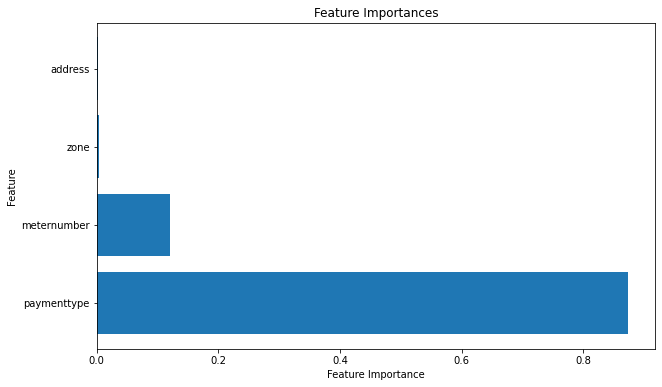

In [324]:
# Checking feature importances for full regression model
feature_importances_full = rf_regressor_full.feature_importances_
# Plotting
plt.figure(figsize=(10, 6))
sorted_idx_full = np.argsort(feature_importances_full)[::-1]
plt.barh(X_full_reg.columns[sorted_idx_full], feature_importances_full[sorted_idx_full])
plt.xlabel("Feature Importance")
plt.ylabel("Feature")
plt.title("Feature Importances")
plt.show()

/datar10/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_partial_dependence is deprecated; Function `plot_partial_dependence` is deprecated in 1.0 and will be removed in 1.2. Use PartialDependenceDisplay.from_estimator instead
  warnings.warn(msg, category=FutureWarning)


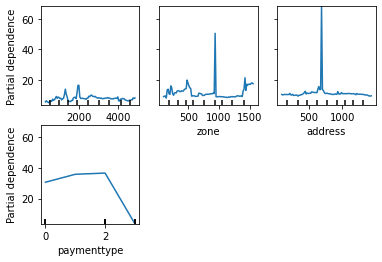

In [326]:
# Plotting partial dependences for full reg model
features_full = ['meternumber', 'zone', 'address', 'paymenttype']
plot_partial_dependence(rf_regressor_full_reg, X_train_full_reg, features_full)
plt.show()

In [69]:
# Evaluating full regression model with MSE & R2
# MSE:
mse_full = mean_squared_error(y_test_full_reg, y_pred_full_reg)

# Calculate coefficient of determination for regression model under 200% occupancy
# Getting observation # and predictor # for adjusted r2
n_full = len(y_test_full_reg)
k_full = X_test_full_reg.shape[1]

# R-squared
r2_full = r2_score(y_test_full_reg, y_pred_full_reg)
# Adjusted R-squared
adjusted_r2_full = 1 - ((1 - r2_full) * (n - 1) / (n - k - 1))

# Results:
print("Mean Squared Error:", mse_full)
print("R-squared:", r2_full)
print("Adjusted R-squared:", adjusted_r2_full)

Mean Squared Error: 396534.659903619
R-squared: 0.3203066959245908
Adjusted R-squared: 0.32029601102297434


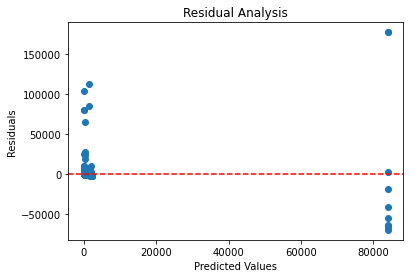

In [328]:
# Calculating residuals for full regression model
residuals_full = y_test_full_reg - y_pred_full_reg
# Plotting
plt.scatter(y_pred_full_reg, residuals_full)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")
plt.title("Residual Analysis")
plt.axhline(y=0, color='r', linestyle='--')
plt.show()

In [329]:
# Performing cross-validation on full regression model
cv_scores_full = cross_val_score(rf_regressor_full, X_full_reg, y_full_reg, cv=5, scoring='neg_mean_squared_error')
# Convert scores to positive MSE values
cv_scores_full = -cv_scores_full

In [330]:
cv_scores_full

array([615159.2652302 , 177580.08940276, 192716.41329001, 604608.68580379,
       731381.65754406])

In [85]:
# Predictive Regression Model for Meters Under 200% Occupancy
# Handling potential missing values
full_merge_slim = full_merge_under.copy()
full_merge_slim.dropna(inplace=True)

# Using LabelEncoder due to lack of computational power, use code chunk below if possible
label_encoder = LabelEncoder()
full_merge_slim['meternumber'] = label_encoder.fit_transform(full_merge_slim['meternumber'])
full_merge_slim['zone'] = label_encoder.fit_transform(full_merge_slim['zone'])
full_merge_slim['address'] = label_encoder.fit_transform(full_merge_slim['address'])
full_merge_slim['paymenttype'] = label_encoder.fit_transform(full_merge_slim['paymenttype'])

# Setting x and y
X_under_reg = full_merge_slim[['meternumber', 'zone', 'address', 'paymenttype', 'longitude', 'latitude']] 
y_under_reg = full_merge_slim['occupancy_percentage']

# Split the data into training and testing
X_train_under_reg, X_test_under_reg, y_train_under_reg, y_test_under_reg = train_test_split(X_under_reg, y_under_reg, test_size=0.2, random_state=42)

# Running Random Forest Regression on training data
rf_regressor_under = RandomForestRegressor(n_estimators=100, random_state=42)
rf_regressor_under.fit(X_train_under_reg, y_train_under_reg)

# Predicting occupancy
y_pred_under_reg = rf_regressor_under.predict(X_test_under_reg)

In [ ]:
# Like with the commented-out code above, I cannot presently run OneHotEncoder on this data, 
# but it would benefit the overall analysis to do so later if possible on a stronger device.

## Necessary libraries:
# from scipy.sparse import hstack
# from scipy.sparse import csr_matrix
## Setting up a predictive occupancy model on meters under 200% occupancy
# full_merge_mod = full_merge_poli.copy()
# full_merge_mod.dropna(inplace=True)

## Encoding categorical variables
# encoder = OneHotEncoder()
# X_encoded = encoder.fit_transform(full_merge_mod[['meternumber', 'zone', 'address', 'paymenttype']])

## Convert 'longitude' and 'latitude' columns to numerical data
# full_merge_mod[['longitude', 'latitude']] = full_merge_mod[['longitude', 'latitude']].astype(float)

## Convert numerical features to sparse matrix
# numerical_features_sparse = csr_matrix(full_merge_mod[['longitude', 'latitude']].values)

## Concatenate sparse matrix with encoded features
# X_full_reg = hstack([numerical_features_sparse, X_encoded])

# y_full_reg = full_merge_mod['occupancy_percentage']

## Splitting data into training and testing
# X_train_full_reg, X_test_full_reg, y_train_full_reg, y_test_full_reg = train_test_split(X_full_reg, y_full_reg, test_size=0.2, random_state=42)

## Training Random Forest
# rf_regressor_full = RandomForestRegressor(n_estimators=100, random_state=42)
# rf_regressor_full.fit(X_train_full_reg, y_train_full_reg)

## Predicting occupancy
# y_pred_full_reg = rf_regressor_full.predict(X_test_full_reg)

In [62]:
# Baseline check for data with all meters under 200% occupancy
# Calculating occupancy mean of training data
mean_baseline_prediction_under = np.mean(y_train_under_reg)

# Creating prediction array with proper length
mean_baseline_predictions_under = np.full_like(y_test_under_reg, fill_value=mean_baseline_prediction_under)

# Calculate mean squared error (MSE) between mean baseline predictions and actual y_test 
mse_baseline_under = mean_squared_error(y_test_under_reg, mean_baseline_predictions_under)

# Getting observation # and predictor # for adjusted r2
n_under = len(y_test_under_reg)
k_under = X_test_under_reg.shape[1]

# R-squared
r2_baseline_under = r2_score(y_test_under_reg, mean_baseline_predictions_under)
# Adjusted R-squared
adj_r2_baseline_under = 1 - ((1 - r2_baseline_under) * (n - 1) / (n - k - 1))

# Evaluating:
print("Mean Prediction (Baseline Sub-200%):", mean_baseline_prediction_under)
print("Mean Squared Error (Baseline Sub-200%):", mse_baseline_under)
print("R-squared (Baseline Sub-200%):", r2_baseline_under)
print('{:.20f}'.format(r2_baseline_under)) # to see it w/o scientific notation
print("Adjusted R-squared (Baseline Sub-200%):", adj_r2_baseline_under)
print('{:.20f}'.format(adj_r2_baseline_under)) # to see it w/o scientific notation

Mean Prediction (Baseline Sub-200%): 6.7464431803565805
Mean Squared Error (Baseline Sub-200%): 7269.46993214631
R-squared (Baseline Sub-200%): -3.285642524719634e-07
-0.00000032856425247196
Adjusted R-squared (Baseline Sub-200%): -1.604875019967089e-05
-0.00001604875019967089


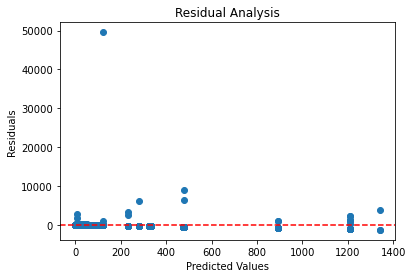

In [86]:
# Residual calculations for regression model under 200% occupancy
residuals_under = y_test_under_reg - y_pred_under_reg
# Plotting
plt.scatter(y_pred_under_reg, residuals_under)
plt.xlabel("Predicted Values")
plt.ylabel("Residuals")
plt.title("Residual Analysis")
plt.axhline(y=0, color='r', linestyle='--')
plt.show()

In [87]:
# Evaluating full regression model with MSE & R2
# MSE:
mse_under = mean_squared_error(y_test_under_reg, y_pred_under_reg)

# Calculate coefficient of determination for regression model under 200% occupancy
# Getting observation # and predictor # for adjusted r2
n_under = len(y_test_under_reg)
k_under = X_test_under_reg.shape[1]

# R-squared
r2_under = r2_score(y_test_under_reg, y_pred_under_reg)
# Adjusted R-squared
adjusted_r2_under = 1 - ((1 - r2_under) * (n - 1) / (n - k - 1))

# Results:
print("Mean Squared Error:", mse_under)
print("R-squared:", r2_under)
print("Adjusted R-squared:", adjusted_r2_under)

Mean Squared Error: 7199.810146627243
R-squared: 0.00958218695021995
Adjusted R-squared: 0.009566617403149014


In [89]:
# Turning predictions from model under 200% into geodata and a leaflet
# Creating data frame of predicted results:
predicted_results = pd.DataFrame({'meternumber': X_test_under_reg['meternumber'],
            'latitude': X_test_under_reg['latitude'],
             'longitude': X_test_under_reg['longitude'],
             'predicted_occupancy': y_pred_under_reg})

In [90]:
predicted_results

,meternumber,latitude,longitude,predicted_occupancy
1559034,5068,38.88524,-77.02615,14.941956
1650129,4803,38.89504,-77.00291,3.956863
1556609,791,38.91647,-77.04159,3.140052
144549,2244,38.89321,-77.04307,15.925220
143947,1263,38.8974,-77.02947,1.568200
...,...,...,...,...
1765767,3494,38.91262,-77.0785,4.654778
365578,3342,38.95803,-77.08407,5.187065
607293,4299,38.90037,-76.99019,6.328239
468198,716,38.89475,-77.03937,2.010039


In [91]:
# Calculating average occupancy across the year
avg_pred_meter_occ = predicted_results.groupby(['longitude', 'latitude', 'meternumber'])['predicted_occupancy'].mean().reset_index()
avg_pred_meter_occ = avg_pred_meter_occ.rename(columns={'predicted_occupancy': 'mean_pred_occ_pct'})
avg_pred_meter_occ.head()

,longitude,latitude,meternumber,mean_pred_occ_pct
0,-76.95081,38.86555,4972,1.395973
1,-76.95081,38.86555,4973,3.641589
2,-76.95963,38.86917,4970,2.165152
3,-76.95966,38.86917,4969,2.093343
4,-76.95979,38.86921,4967,1.734314


In [92]:
# Turning longitude and latitude columns into a geometry column for the predicted data
avg_pred_meter_occ['latitude'] = pd.to_numeric(avg_pred_meter_occ['latitude'], errors='coerce')
avg_pred_meter_occ['longitude'] = pd.to_numeric(avg_pred_meter_occ['longitude'], errors='coerce')
gdf_pred_occ = gpd.GeoDataFrame(avg_pred_meter_occ, geometry=gpd.points_from_xy(avg_pred_meter_occ.longitude, avg_pred_meter_occ.latitude))

# Ensuring CRS is correct
gdf_pred_occ.crs = "EPSG:4326" 

In [94]:
# DBSCAN Leaflet on Predicted Data
# Handling potential missing values
gdf_pred_occ.dropna(inplace=True)
gdf_pred_occ.replace([np.inf, -np.inf], np.nan, inplace=True)
gdf_pred_occ.dropna(inplace=True)

# Setting X variable
X_under = gdf_pred_occ[['latitude', 'longitude', 'mean_pred_occ_pct']]

# Standardizing features and Appling DBSCAN clustering
X_scaled_under = StandardScaler().fit_transform(X_under)
dbscan = DBSCAN(eps=0.1, min_samples=5)
clusters_under = dbscan.fit_predict(X_scaled_under)

# Adding cluster labels
gdf_pred_occ['predicted_cluster'] = clusters_under
y_under = gdf_pred_occ['predicted_cluster']

# Mapping
m_under = folium.Map(location=[38.9072, -77.0369], zoom_start=12)
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'pink', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
for index, row in gdf_pred_occ.iterrows():
    color = 'gray' if row['predicted_cluster'] == -1 else colors[row['predicted_cluster'] % len(colors)]  # Assigning gray color to noise points/outliers
    folium.CircleMarker(location=[row['latitude'], row['longitude']], 
                        radius=5, 
                        color=color,
                        fill=True,
                        fill_color=color, 
                        fill_opacity=0.7,
                        popup=f'Predicted Cluster: {row["predicted_cluster"]} | Occupancy: {row["mean_pred_occ_pct"]}%').add_to(m_under)

# Display:
m_under